# analysis the data:
Rank: Ranking of the game based on global sales.

Name: Name of the game.

Platform: Platform of the game release (e.g., Wii, NES, GB).

Year: Year of release.

Genre: Genre of the game (e.g., Sports, Platform, Racing, Role-Playing).

Publisher: Publisher of the game.

NA_Sales: Sales in North America (in millions).

EU_Sales: Sales in Europe (in millions).

JP_Sales: Sales in Japan (in millions).

Other_Sales: Sales in other regions (in millions).

Global_Sales: Total global sales (in millions).


In [1]:
import numpy as np
import pandas as pd
import seaborn as sns 
import matplotlib.pyplot as plt
from sklearn.impute import KNNImputer
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
import plotly.express as px
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error
import plotly.graph_objects as go

In [2]:
df=pd.read_csv("vgsales.csv" , sep = "," , encoding = "utf-8")

In [3]:
df.head()

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales
0,1,Wii Sports,Wii,2006.0,Sports,Nintendo,41.49,29.02,3.77,8.46,82.74
1,2,Super Mario Bros.,NES,1985.0,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24
2,3,Mario Kart Wii,Wii,2008.0,Racing,Nintendo,15.85,12.88,3.79,3.31,35.82
3,4,Wii Sports Resort,Wii,2009.0,Sports,Nintendo,15.75,11.01,3.28,2.96,33.00
4,5,Pokemon Red/Pokemon Blue,GB,1996.0,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.37


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16598 entries, 0 to 16597
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Rank          16598 non-null  int64  
 1   Name          16598 non-null  object 
 2   Platform      16598 non-null  object 
 3   Year          16327 non-null  float64
 4   Genre         16598 non-null  object 
 5   Publisher     16540 non-null  object 
 6   NA_Sales      16598 non-null  float64
 7   EU_Sales      16598 non-null  float64
 8   JP_Sales      16598 non-null  float64
 9   Other_Sales   16598 non-null  float64
 10  Global_Sales  16598 non-null  float64
dtypes: float64(6), int64(1), object(4)
memory usage: 1.4+ MB


In [5]:
df.shape

(16598, 11)

In [6]:
df.describe()

,Rank,Year,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales
count,16598.000000,16327.000000,16598.000000,16598.000000,16598.000000,16598.000000,16598.000000
mean,8300.605254,2006.406443,0.264667,0.146652,0.077782,0.048063,0.537441
std,4791.853933,5.828981,0.816683,0.505351,0.309291,0.188588,1.555028
min,1.000000,1980.000000,0.000000,0.000000,0.000000,0.000000,0.010000
25%,4151.250000,2003.000000,0.000000,0.000000,0.000000,0.000000,0.060000
50%,8300.500000,2007.000000,0.080000,0.020000,0.000000,0.010000,0.170000
75%,12449.750000,2010.000000,0.240000,0.110000,0.040000,0.040000,0.470000
max,16600.000000,2020.000000,41.490000,29.020000,10.220000,10.570000,82.740000


In [7]:
df['Name'].value_counts()

Name
Need for Speed: Most Wanted                12
Ratatouille                                 9
FIFA 14                                     9
LEGO Marvel Super Heroes                    9
Madden NFL 07                               9
                                           ..
Ar tonelico Qoga: Knell of Ar Ciel          1
Galaga: Destination Earth                   1
Nintendo Presents: Crossword Collection     1
TrackMania: Build to Race                   1
Know How 2                                  1
Name: count, Length: 11493, dtype: int64

In [57]:
top_games = df.groupby('Name')['Global_Sales'].sum().nlargest(10)

s = px.data.stocks()
fig = px.histogram(df, x=top_games.index,y=top_games.values)
fig.update_layout(bargap=0.2,yaxis_title='Global Sales', xaxis_title='Names',)
fig.show()
#the most golbal sales is Wii Sports

In [59]:
#s = px.data.stocks()
#fig = px.line(df, x='Name', y="Global_Sales")
#fig.show()

In [10]:
df['Platform'].value_counts()

Platform
DS      2163
PS2     2161
PS3     1329
Wii     1325
X360    1265
PSP     1213
PS      1196
PC       960
XB       824
GBA      822
GC       556
3DS      509
PSV      413
PS4      336
N64      319
SNES     239
XOne     213
SAT      173
WiiU     143
2600     133
NES       98
GB        98
DC        52
GEN       27
NG        12
SCD        6
WS         6
3DO        3
TG16       2
GG         1
PCFX       1
Name: count, dtype: int64

In [11]:
s = px.data.stocks()
fig = px.histogram(df, x="Platform")
fig.update_layout(bargap=0.2)
fig.show()
#The DS platform is the highest, followed by a small difference, PS2

In [12]:
fig = px.histogram(
    df,
    x='Platform',
    y = "Global_Sales",
    animation_frame='Year',
    range_y=[0, 550],
)
fig.update_layout(title = "platforms global sales animation",
                  xaxis_title = "Platforms.",
                  yaxis_title = "the global sales.")
fig

C:\Users\Ahmed fawzi\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [13]:
s = px.data.iris() 
fig = px.scatter(df, x="Platform", y="Global_Sales",color='Global_Sales')
fig.show()
#The most expensive game ever sold was for the Wii platform, at a price of 82.74

In [14]:
##Year-wise Sales

year_sales = df.groupby('Year')['Global_Sales'].sum()

fig = px.line(x=year_sales.index, y=year_sales.values)
fig.update_layout(
    title='Global Sales by Year',
    xaxis_title='Year',
    yaxis_title='Global Sales',
    font=dict(color='black')  # Font color
)

fig.show()
#Sales increased significantly between 1995 and 2015 and reached their peak in 2006.

In [45]:
s = px.data.iris() 
fig = px.scatter(df, x="Year", y="Global_Sales",color='Global_Sales')
fig.show()
#1980s: There are a few games with significant sales, but the volume is relatively low.
#1990s: Sales volumes start to increase with a more consistent number of games having notable sales.
#2000s: There is a significant increase in both the number of games released and their global sales, peaking around the mid-2000s.
#2010s: While there are still many games with significant sales, the overall trend shows a slight decrease in the number of extremely high-selling games compared to the peak in the mid-2000s.
#The most expensive game released in 2006

In [16]:
df['Genre'].value_counts()

Genre
Action          3316
Sports          2346
Misc            1739
Role-Playing    1488
Shooter         1310
Adventure       1286
Racing          1249
Platform         886
Simulation       867
Fighting         848
Strategy         681
Puzzle           582
Name: count, dtype: int64

In [17]:
s = px.data.stocks()
fig = px.histogram(df, x="Genre")
fig.update_layout(bargap=0.2)
fig.show()
#Action is the highest type of game

In [18]:
tops_games = df.groupby('Genre')['Global_Sales'].sum().nlargest(11)
s = px.data.stocks()
fig = px.histogram(df, x=tops_games.index,y=tops_games.values)
fig.update_layout(bargap=0.2,yaxis_title='Global Sales', xaxis_title='Genre',)
fig.show()
#Action is the best seller

In [19]:
s = px.data.tips()
fig = px.pie(df, values='Global_Sales', names='Genre')
fig.show()
#Action affects 19.6% of global sales

In [20]:
fig = px.histogram(
    df,
    x='Genre',
    y = "Global_Sales",
    animation_frame='Year',
    range_y=[0, 550],
)
fig.update_layout(title = "Genre global sales animation",
                  xaxis_title = "Genre.",
                  yaxis_title = "the global sales.")
fig

C:\Users\Ahmed fawzi\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [21]:
px.scatter(df , x = "Global_Sales", y = "Genre", animation_frame="Year",
           size = "Global_Sales", color = "Platform", log_x = True,
           size_max = 55 , range_x = [1 , 100000000])

In [22]:
df['Publisher'].value_counts()

Publisher
Electronic Arts                 1351
Activision                       975
Namco Bandai Games               932
Ubisoft                          921
Konami Digital Entertainment     832
                                ... 
Warp                               1
New                                1
Elite                              1
Evolution Games                    1
UIG Entertainment                  1
Name: count, Length: 578, dtype: int64

In [23]:
top_publishers = df.groupby('Publisher')['Global_Sales'].sum().nlargest(10)


fig = px.bar(x=top_publishers.index, y=top_publishers.values)

fig.update_layout(
    bargap=0.2,
    title='Top 10 Publishers by Global Sales',
    xaxis_title='Publisher',
    yaxis_title='Global Sales (in millions)',
)

fig.update_traces(text=top_publishers.values, texttemplate='%{text:.2f}M', textposition='outside')

fig.show()
#top 

In [24]:
s = px.data.tips()
fig = px.pie(df, values=top_publishers.values, names=top_publishers.index)
fig.show()
#Nintendo has the highest sales percentage

In [25]:
s = px.data.iris() 
fig = px.scatter(df, x="Publisher", y="Global_Sales",color='Global_Sales')
fig.show()

In [26]:
fig = px.bar(df, x = "Platform" , y = "Global_Sales" , text = "Genre" , color = "Publisher", title = "platforms Global sacles and factors effecting it",
            labels = {"y" : "Global sales"})
fig.update_traces(textposition = "outside")
fig.update_layout(uniformtext_minsize = 8 , xaxis_tickangle = -45)
fig.show()

C:\Users\Ahmed fawzi\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [27]:
df['NA_Sales'].describe()

count    16598.000000
mean         0.264667
std          0.816683
min          0.000000
25%          0.000000
50%          0.080000
75%          0.240000
max         41.490000
Name: NA_Sales, dtype: float64

In [46]:
s = px.data.iris() 
fig = px.scatter(df, x="NA_Sales", y="Global_Sales",color='Global_Sales')
fig.show()

In [47]:
fig = px.line(df, x='NA_Sales', y='Global_Sales', color='Platform')
fig.show()

C:\Users\Ahmed fawzi\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [48]:
df['JP_Sales'].describe()

count    16598.000000
mean         0.077782
std          0.309291
min          0.000000
25%          0.000000
50%          0.000000
75%          0.040000
max         10.220000
Name: JP_Sales, dtype: float64

In [49]:
s = px.data.iris() 
fig = px.scatter(df, x="JP_Sales", y="Global_Sales",color='Global_Sales')
fig.show()
#most jp salles 3.77

In [50]:
fig = px.line(df, x='JP_Sales', y='Global_Sales', color='Platform')
fig.show()

C:\Users\Ahmed fawzi\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [51]:
df['EU_Sales'].describe()

count    16598.000000
mean         0.146652
std          0.505351
min          0.000000
25%          0.000000
50%          0.020000
75%          0.110000
max         29.020000
Name: EU_Sales, dtype: float64

In [52]:
s = px.data.iris() 
fig = px.scatter(df, x="EU_Sales", y="Global_Sales",color='Global_Sales')
fig.show()

In [53]:
fig = px.line(df, x='EU_Sales', y='Global_Sales', color='Platform')
fig.show()

C:\Users\Ahmed fawzi\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [54]:
df['Other_Sales'].describe()

count    16598.000000
mean         0.048063
std          0.188588
min          0.000000
25%          0.000000
50%          0.010000
75%          0.040000
max         10.570000
Name: Other_Sales, dtype: float64

In [55]:
s = px.data.iris() 
fig = px.scatter(df, x="Other_Sales", y="Global_Sales",color='Global_Sales')
fig.show()

In [38]:
df['Global_Sales'].describe()

count    16598.000000
mean         0.537441
std          1.555028
min          0.010000
25%          0.060000
50%          0.170000
75%          0.470000
max         82.740000
Name: Global_Sales, dtype: float64

In [39]:
s = px.data.iris() 
fig = px.scatter(df, x="Global_Sales", y="Global_Sales",color='Global_Sales')
fig.show()

In [40]:
colors_list = ["blue", "green", "red", "purple"]
fig = go.Figure(data = [go.Pie(values = [df.NA_Sales.sum(), df.EU_Sales.sum() ,df.JP_Sales.sum() ,df.Other_Sales.sum()] , labels = ["north America sales", "europe sales", "japan sales", "othor sales"])])
fig.update_traces(hoverinfo = "label+percent", textfont_size = 20 ,
                  textinfo = "label+percent" , pull = [0 ,0 ,0,0.2],
                  marker = dict(colors = colors_list , line = dict(
                      color = "#FFFFFF", width =1
                  )))

fig.show()

In [56]:
fig =px.scatter_3d(df , x = "NA_Sales", y = "EU_Sales", z = "JP_Sales",color = "Global_Sales", opacity = 0.8)
fig.show()

In [42]:
fig = px.scatter_ternary(df, 
                         a="NA_Sales", 
                         b="EU_Sales", 
                         c="JP_Sales", 
                         color="Global_Sales", 
                         hover_data=["Other_Sales"],
                         title="Sales Places Relation with Respect to Other Sales",
                         labels={"a": "North America", "b": "Europe Sales", "c": "Japan Sales"})
fig.show()

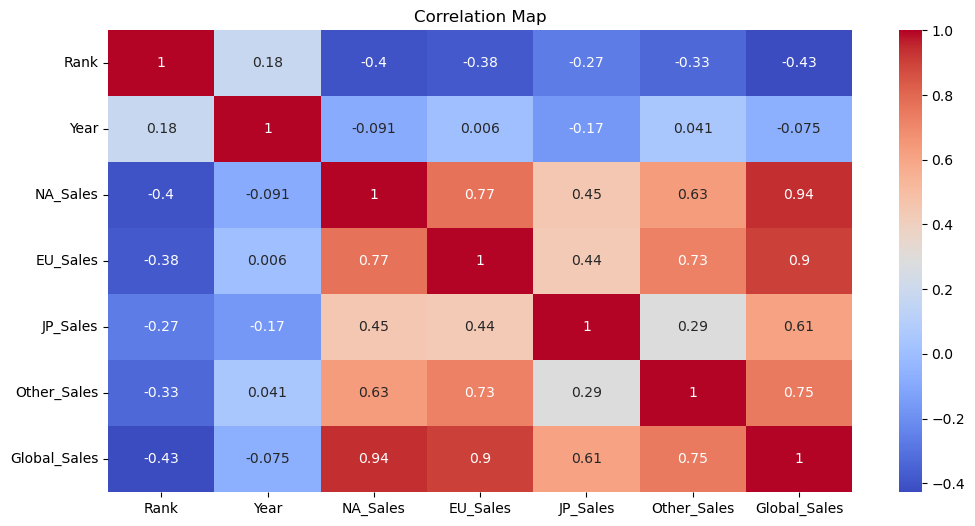

In [43]:
numerical_data=df.select_dtypes(include=[np.number])
plt.figure(figsize=(12,6))
sns.heatmap(data=numerical_data.corr(), annot=True, cmap='coolwarm')
plt.title('Correlation Map')
plt.show()
#global sales More closely affected by EU sales and NA_sales

In [44]:
import plotly.express as px
import pandas as pd

# Load the data
df2 = df.copy()

# Filter out rows where Year is NaN and convert Year to integer
df2 = df2.dropna(subset=['Year'])
df2['Year'] = df2['Year'].astype(int)

# Create a new dataframe for visualization with yearly sales
visualization_data = pd.DataFrame()

# Loop through each unique year and calculate regional sales
for year in df2['Year'].unique():
    year_data = df2[df2['Year'] == year]
    region_sales = pd.DataFrame({
        'Year': [year] * 4,
        'Region': ['North America', 'Europe', 'Japan', 'Other'],
        'Sales': [
            year_data['NA_Sales'].sum(),
            year_data['EU_Sales'].sum(),
            year_data['JP_Sales'].sum(),
            year_data['Other_Sales'].sum()
        ],
        'iso_alpha': ['USA', 'FRA', 'JPN', 'AUS']  # Example country codes
    })
    visualization_data = pd.concat([visualization_data, region_sales], ignore_index=True)

# Plot the data
fig = px.scatter_geo(
    visualization_data, 
    locations="iso_alpha", 
    color="Region", 
    hover_name="Region", 
    size="Sales",
    animation_frame="Year",
    projection="natural earth"
)
fig.show()
